In [80]:
import sympy as sp

""" This module contains functions for working with metrics in different coordinate systems. """

def getMetric(lineElement, coordSystem="Cartesian", subs=None, overrideConst = False): #the override lets the code run faster if you know for sure your line element will work out
    if coordSystem not in ["Cartesian", "PlanePolar", "SphericalPolar", "CylindricalPolar"]:
        raise ValueError("Unknown coordinate system")

    lineElement=sp.expand(lineElement)
    coords = (t, x, y, z)

    dim = len(coords)
    g = sp.zeros(dim)

    for mu in range(dim):
        for nu in range(dim):
            coeff = lineElement.coeff(sp.diff(coords[mu]) * sp.diff(coords[nu]))
            if mu != nu and coeff != 0:
                g[mu, nu] = coeff.subs(subs) / 2
            else:
                g[mu, nu] = coeff.subs(subs)

    # Check for unexpected terms in the line element
    if not overrideConst:
        reconstructed_line_element = sum(g[i, j] * sp.diff(coords[i]) * sp.diff(coords[j]) for i in range(dim) for j in range(dim))
        if sp.simplify(lineElement.subs(subs) - reconstructed_line_element) != 0:
            raise ValueError("Line element contains terms that are not pure differentials of the coordinates used")
    return g

In [81]:
""" Intial setup for Alcubeirre metric in Cartesian coordinates """

vs, sigma, R, lam = sp.symbols('v_s sigma R lambda')
t = sp.Function('t')(lam)
x = sp.Function('x')(lam)
y = sp.Function('y')(lam)
z = sp.Function('z')(lam)

dt=sp.diff(t)
dx=sp.diff(x)
dy=sp.diff(y)
dz=sp.diff(z)

# for now, define constants as symbols
xs, r, f_r, c = sp.symbols("x_s r f_r c")

lineElement = -c**2*dt**2 + (dx - vs*f_r*dt)**2 + dy**2 + dz**2
display(lineElement)

# order of substitutions matter!!!
subs= [
    (f_r, (sp.tanh(sigma * (r + R)) - sp.tanh(sigma * (r - R))) / (2 * sp.tanh(sigma * R))),
    (r, sp.sqrt((x - xs)**2 + y**2 + z**2)),
    (xs, vs*t), # since its steady state
]

metric=getMetric(lineElement, "Cartesian", subs, True)
metric

-c**2*Derivative(t(lambda), lambda)**2 + (-f_r*v_s*Derivative(t(lambda), lambda) + Derivative(x(lambda), lambda))**2 + Derivative(y(lambda), lambda)**2 + Derivative(z(lambda), lambda)**2

Matrix([
[-c**2 + v_s**2*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))**2/(4*tanh(R*sigma)**2), -v_s*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))/(2*tanh(R*sigma)), 0, 0],
[                -v_s*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))/(2*tanh(R*sigma)),                                                                                                                                                                                                        1, 0, 0],
[                                                                                                                                      

In [82]:
""" Computing Christoffel symbols """

import numpy as np
from itertools import product

metric_inv = metric.inv()
print("start computation")
n=4
X = [t, x, y, z]
# computing the symbols using the metric equation
# Create array to store the computed christoffel symbols.
christoffel_symbols = np.zeros(shape=n, dtype='object')
simple = False
for i in range(n):
    dummy_matrix = sp.Matrix.zeros(n,n)
    for (j,k,l) in product(range(n), repeat=3):
        dummy_matrix[j,k] += (
            sp.Rational(1/2)*metric_inv[i,l] * (sp.diff(metric[l,j],X[k])
            +sp.diff(metric[l,k],X[j]) - sp.diff(metric[j,k],X[l]))
        )
        print(f"done connection j: {j} k: {k} l: {l}")
    christoffel_symbols[i] = sp.simplify(dummy_matrix) if simple else dummy_matrix

start computation
done connection j: 0 k: 0 l: 0
done connection j: 0 k: 0 l: 1
done connection j: 0 k: 0 l: 2
done connection j: 0 k: 0 l: 3
done connection j: 0 k: 1 l: 0
done connection j: 0 k: 1 l: 1
done connection j: 0 k: 1 l: 2
done connection j: 0 k: 1 l: 3
done connection j: 0 k: 2 l: 0
done connection j: 0 k: 2 l: 1
done connection j: 0 k: 2 l: 2
done connection j: 0 k: 2 l: 3
done connection j: 0 k: 3 l: 0
done connection j: 0 k: 3 l: 1
done connection j: 0 k: 3 l: 2
done connection j: 0 k: 3 l: 3
done connection j: 1 k: 0 l: 0
done connection j: 1 k: 0 l: 1
done connection j: 1 k: 0 l: 2
done connection j: 1 k: 0 l: 3
done connection j: 1 k: 1 l: 0
done connection j: 1 k: 1 l: 1
done connection j: 1 k: 1 l: 2
done connection j: 1 k: 1 l: 3
done connection j: 1 k: 2 l: 0
done connection j: 1 k: 2 l: 1
done connection j: 1 k: 2 l: 2
done connection j: 1 k: 2 l: 3
done connection j: 1 k: 3 l: 0
done connection j: 1 k: 3 l: 1
done connection j: 1 k: 3 l: 2
done connection j: 1 

In [83]:
""" Displaying the Christoffel symbols """

for i in range(n):
    display(christoffel_symbols[i])

C = christoffel_symbols

Matrix([
[-v_s**2*(2*sigma*v_s*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*(-v_s*t(lambda) + x(lambda))/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2) - 2*sigma*v_s*(1 - tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*(-v_s*t(lambda) + x(lambda))/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))/(8*c**2*tanh(R*sigma)**2) + (-v_s*tanh(R*sigma - sigma*sqrt(v_s**2*t(lambda)**2 - 2*v_s*t(lambda)*x(lambda) + x(lambda)**2 + y(lambda)**2 + z(lambda)**2)) - v_s*tanh(R*sigma + sigma*sqrt(v_s**2*t(lambda)**2 - 2*v_s*t(lambda)*x(lambda) + x(lambda)**2 + y(lambda)**2 + z(lambda)**2)))*(-v_s**2*(-2*sigma*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)

Matrix([
[v_s**2*(-v_s*tanh(R*sigma - sigma*sqrt(v_s**2*t(lambda)**2 - 2*v_s*t(lambda)*x(lambda) + x(lambda)**2 + y(lambda)**2 + z(lambda)**2)) - v_s*tanh(R*sigma + sigma*sqrt(v_s**2*t(lambda)**2 - 2*v_s*t(lambda)*x(lambda) + x(lambda)**2 + y(lambda)**2 + z(lambda)**2)))*(2*sigma*v_s*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*(-v_s*t(lambda) + x(lambda))/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2) - 2*sigma*v_s*(1 - tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*(-v_s*t(lambda) + x(lambda))/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))/(16*c**2*tanh(R*sigma)**3) + (-v_s**2*(-2*sigma*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)

Matrix([
[-v_s**2*(-2*sigma*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*y(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2) + 2*sigma*(1 - tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*y(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))/(8*tanh(R*sigma)**2), v_s*(-sigma*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*y(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2) + sigma*(1 - tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*y(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))/(4*tanh(R*sigma)), 0, 0],
[                   

Matrix([
[-v_s**2*(-2*sigma*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*z(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2) + 2*sigma*(1 - tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*z(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))*(-tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))) + tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))))/(8*tanh(R*sigma)**2), v_s*(-sigma*(1 - tanh(sigma*(-R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*z(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2) + sigma*(1 - tanh(sigma*(R + sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2)))**2)*z(lambda)/sqrt((-v_s*t(lambda) + x(lambda))**2 + y(lambda)**2 + z(lambda)**2))/(4*tanh(R*sigma)), 0, 0],
[                   

In [86]:

""" Define momentum vector in terms of lambda """

pt = sp.diff(t, lam)
px = sp.diff(x, lam)
py = sp.diff(y, lam)
pz = sp.diff(y, lam)

dt = sp.diff(t)
dx = sp.diff(x)
dy = sp.diff(y)
dz = sp.diff(z)

""" Compute change in momentum vector with respect to lambda """

Ct, Cx, Cy, Cz = C[0], C[1], C[2], C[3]
dptdl = -1 * (Ct[0,0] * pt**2 + Ct[1,1] * px**2 + Ct[2,2] * py**2 + Ct[3,3] * pz**2 + 2 * (Ct[0,1] * pt * px + Ct[0,2] * pt * py + Ct[0,3] * pt * pz + Ct[1,2] * px * py + Ct[1,3] * px * pz + Ct[2,3] * py * pz))
dpxdl = -1 * (Cx[0,0] * pt**2 + Cx[1,1] * px**2 + Cx[2,2] * py**2 + Cx[3,3] * pz**2 + 2 * (Cx[0,1] * pt * px + Cx[0,2] * pt * py + Cx[0,3] * pt * pz + Cx[1,2] * px * py + Cx[1,3] * px * pz + Cx[2,3] * py * pz))
dpydl = -1 * (Cy[0,0] * pt**2 + Cy[1,1] * px**2 + Cy[2,2] * py**2 + Cy[3,3] * pz**2 + 2 * (Cy[0,1] * pt * px + Cy[0,2] * pt * py + Cy[0,3] * pt * pz + Cy[1,2] * px * py + Cy[1,3] * px * pz + Cy[2,3] * py * pz))
dpzdl = -1 * (Cz[0,0] * pt**2 + Cz[1,1] * px**2 + Cz[2,2] * py**2 + Cz[3,3] * pz**2 + 2 * (Cz[0,1] * pt * px + Cz[0,2] * pt * py + Cz[0,3] * pt * pz + Cz[1,2] * px * py + Cz[1,3] * px * pz + Cz[2,3] * py * pz))


In [2]:
import sympy as sp
import numpy as np

vs, sigma, R, lam, c= sp.symbols('v_s sigma R lambda c')

t = sp.Function('t')(lam)
x = sp.Function('x')(lam)
y = sp.Function('y')(lam)
z = sp.Function('z')(lam)

dt=sp.diff(t)
dx=sp.diff(x)
dy=sp.diff(y)
dz=sp.diff(z)

pt = sp.diff(t, lam)
px = sp.diff(x, lam)
py = sp.diff(y, lam)
pz = sp.diff(y, lam)

dptdl = sp.sympify(open("dptdl.txt", "r").read())
dpxdl = sp.sympify(open("dpxdl.txt", "r").read())
dpydl = sp.sympify(open("dpydl.txt", "r").read())
dpzdl = sp.sympify(open("dpzdl.txt", "r").read())
pt1 = sp.sympify(open("pt1.txt", "r").read())
pt2 = sp.sympify(open("pt2.txt", "r").read())

dptdl_lambda = sp.lambdify((t, x, y, z, dt, dx, dy, dz, vs,R,sigma,c), dptdl, "numpy")
dpxdl_lambda = sp.lambdify((t, x, y, z, dt, dx, dy, dz, vs,R,sigma,c), dpxdl, "numpy")
dpydl_lambda = sp.lambdify((t, x, y, z, dt, dx, dy, dz, vs,R,sigma,c), dpydl, "numpy")
dpzdl_lambda = sp.lambdify((t, x, y, z, dt, dx, dy, dz, vs,R,sigma,c), dpzdl, "numpy")


pt1_lambda = sp.lambdify((t,x,y,z,vs,R,sigma,c,px,py,pz), pt1, "numpy")
pt2_lambda = sp.lambdify((t,x,y,z,vs,R,sigma,c,px,py,pz), pt2, "numpy")


In [39]:
""" setup intial conditions"""

dL = 0.001
iterations = 100000
vs_val = 0.8
R_val = 1
sigma_val = 5
c_val = 1

# if you want to use the same initial conditions as the paper
angles_len = 100
angles = np.linspace(0, 2 * np.pi, angles_len)

# if you want to use random initial conditions
number_of_rays = 10
x_direction = 5
y_direction = 3

values = np.zeros((x_direction * y_direction, 8))
values[:,0] = 0
values[:, 1] = 0
values[:, 2] = 0
values[:, 3] = -1
# values[:, 4] = 1
values[:, 5] = np.tile(np.linspace(-1, 1, x_direction), y_direction)
values[:,6] = np.repeat(np.linspace(-1, 1, y_direction), x_direction)
values[:, 7] = 1


values[:,5:] = values[:,5:] / np.linalg.norm(values[:,5:], axis=1, keepdims=True)
print(values)
args = (values[:, 0], values[:, 1], values[:, 2], values[:, 3], vs_val , R_val, sigma_val, c_val, values[:, 5], values[:, 6], values[:, 7])
values[:, 4] = pt1_lambda(*args) # pt2_lambda(*args)


[[ 0.          0.          0.         -1.          0.         -0.57735027
  -0.57735027  0.57735027]
 [ 0.          0.          0.         -1.          0.         -0.33333333
  -0.66666667  0.66666667]
 [ 0.          0.          0.         -1.          0.          0.
  -0.70710678  0.70710678]
 [ 0.          0.          0.         -1.          0.          0.33333333
  -0.66666667  0.66666667]
 [ 0.          0.          0.         -1.          0.          0.57735027
  -0.57735027  0.57735027]
 [ 0.          0.          0.         -1.          0.         -0.70710678
   0.          0.70710678]
 [ 0.          0.          0.         -1.          0.         -0.4472136
   0.          0.89442719]
 [ 0.          0.          0.         -1.          0.          0.
   0.          1.        ]
 [ 0.          0.          0.         -1.          0.          0.4472136
   0.          0.89442719]
 [ 0.          0.          0.         -1.          0.          0.70710678
   0.          0.70710678]
 [ 0.   

In [40]:
values[:,4]

array([-0.85025775, -0.9438464 , -1.09110832, -1.26134652, -1.4001841 ,
       -1.04134881, -1.26630282, -1.54306019, -1.69227394, -1.71486829,
       -0.85025775, -0.9438464 , -1.09110832, -1.26134652, -1.4001841 ])

In [27]:
""" Solve by steps """
import time

geods = []
L = 0


def dp_solve(args):
  return np.array([
                    dptdl_lambda(*args),
                    dpxdl_lambda(*args),
                    dpydl_lambda(*args),
                    dpzdl_lambda(*args),
    ]).T

def return_args(h, k, args):
  t,x,y,z,pt,px,py,pz,vs,R,sigma,c = args

  pt = pt + h*k[:,0]
  px = px + h*k[:,1]
  py = py + h*k[:,2]
  pz = pz + h*k[:,3]

  t = t + h*pt
  x = x + h*px
  y = y + h*py
  z = z + h*pz

  return (t,x,y,z,pt,px,py,pz,vs,R,sigma,c)

def RK4(y, h, function, args):

  k1 = function(args)
  k2 = function(return_args(h/2,k1, args))
  k3 = function(return_args(h/2,k2, args))
  k4 = function(return_args(h,k3, args))

  return y + h/6 * (k1 + 2*k2 + 2*k3 + k4)


print("start computation ... \n")
start = time.time()

for i in range(int(iterations)):
    L += dL

    args = (
        values[:, 0], values[:, 1], values[:, 2],
        values[:, 3], values[:, 4], values[:, 5],
        values[:, 6], values[:, 7],
        vs_val, R_val, sigma_val, c_val
    )
    values[:, 4:] = RK4(values[:, 4:], dL, dp_solve, args)
    values[:,:4] += values[:,4:] * dL
    geods.append(np.copy(values))
    print("Percentage done: {:3.5f} %".format((i/iterations)*100), end="\r")

print("Elapsed time: {:3.2f} seconds".format(time.time()-start))
geods = np.array(geods)
print(geods.shape)


start computation ... 

Elapsed time: 20.71 seconds
(1000, 300, 8)


Plotting


In [28]:
import plotly.graph_objects as go
import numpy as np

geods_transposed = geods.transpose(1, 0, 2)

fig = go.Figure()
count = 0

angles_length=1
for geod_angle in geods_transposed:
  positions = geod_angle[:, 0:4]
  velocities = geod_angle[:, 4:]

  ts, xs, ys, zs = zip(*positions)
  tps, xps, yps, zps =  zip(*velocities)

  # Plot for position
  fig.add_trace(go.Scatter3d(x=xs, y=ys, z=zs, mode='lines'))

  # Add initial velocity vector
  fig.add_trace(go.Cone(x=[xs[0]], y=[ys[0]], z=[zs[0]],
              u=[xps[0]], v=[yps[0]], w=[zps[0]],
              sizemode="scaled",
              sizeref=0.0001,
              anchor="tail"))
  count += 1
  print("plotting, currently: {}%".format(str((count/geods.shape[0])*100)), end="\r")

fig.update_layout(scene = dict(
          xaxis_title='X Position (x)',
          yaxis_title="Y Position (y)",
          zaxis_title="z Position (z)"),
          width=700,
          margin=dict(r=20, b=10, l=10, t=10))

fig.show()


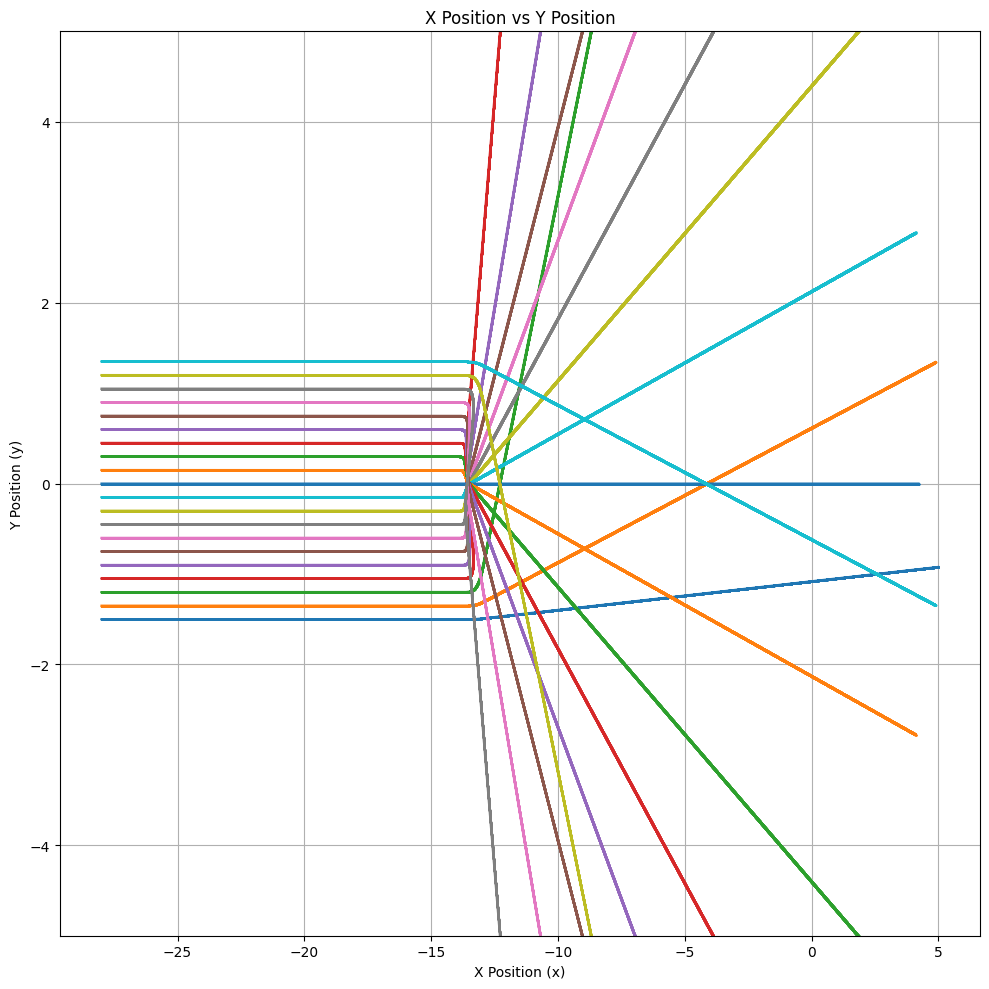

In [112]:
""" for 2d plots """

import matplotlib.pyplot as plt

geods_transposed = geods.transpose(1, 0, 2)

# Creating 2D plots for t-x, t-y, and x-y
fig, ax3 = plt.subplots(1, 1, figsize=(10, 10))  # 1 row, 3 columns

# gamma = 1/(np.sqrt(1-vs_val**2))

# def x_transform(x_val, t_val):
#     return gamma * (x_val - vs_val * t_val)

for geod_angle in geods_transposed:

    positions = geod_angle[:, 0:4]
    velocities = geod_angle[:, 0:4]
    # positions[:,1] = x_transform(positions[:,1], positions[:,0])

    ts, xs, ys, zs = zip(*positions)

    tps, xps, yps, zps =  zip(*velocities)

    # ax1.plot(ts, xs, '.-', linewidth=0.5)  # '.' is the style: line with dots
    # ax1.set_xlabel('Time (t)')
    # ax1.set_ylabel('X Position (x)')
    # ax1.set_title('Time vs X Position')
    # ax1.grid(True)

    # # t-y plot
    # ax2.plot(ts, ys, '.-', linewidth=0.5)  # '.' is the style: line with dots
    # ax2.set_xlabel('Time (t)')
    # ax2.set_ylabel('Y Position (y)')
    # ax2.set_title('Time vs Y Position')
    # ax2.grid(True)

    # x-y plot
    ax3.plot(xs, ys, '.-', markersize=1.0)  # '.' is the style: line with dots
    ax3.set_xlabel('X Position (x)')
    ax3.set_ylabel('Y Position (y)')
    ax3.set_title('X Position vs Y Position')
    ax3.grid(True)
    # ax3.set_xlim([-,0])
    ax3.set_ylim([-5,5])

# Draw a circl
# circle = plt.Circle((0, 0), R_val*(1+vs_val), color='red', alpha=0.5)
# ax3.add_artist(circle)

plt.tight_layout()
plt.show()
